In [1]:
import numpy as np 
import pandas as pd


from glob import glob 
from pathlib import Path
import os
import shutil


from PIL import Image
import cv2
from matplotlib import pyplot as plt 


from sklearn.model_selection import train_test_split


import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras import backend as K

In [3]:
fives_images_paths = glob("/kaggle/input/fives-a-fundus-image/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation/train/Original/*.png") + glob("/kaggle/input/fives-a-fundus-image/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation/test/Original/*.png")
fives_mask_paths = glob("/kaggle/input/fives-a-fundus-image/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation/train/Ground truth/*.png") + glob("/kaggle/input/fives-a-fundus-image/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation/test/Ground truth/*.png")

chasedb_images_paths = glob("/kaggle/input/retinal-vessel-segmentation/CHASE_DB1/Images/*.jpg")
chasedb_mask_paths = glob("/kaggle/input/retinal-vessel-segmentation/CHASE_DB1/Masks/*.png")

hrf_images_paths = glob("/kaggle/input/retinal-vessel-segmentation/HRF/images/*.JPG") + glob("/kaggle/input/retinal-vessel-segmentation/HRF/images/*.jpg")
hrf_mask_paths = glob("/kaggle/input/retinal-vessel-segmentation/HRF/manual1/*.tif")

test_images_paths = glob("/kaggle/input/retina-blood-vessel/Data/test/image/*.png")
test_mask_paths = glob("/kaggle/input/retina-blood-vessel/Data/test/mask/*.png")

In [4]:
Path('/kaggle/working/Fives-Data/').mkdir(parents=True, exist_ok=True)
Path('/kaggle/working/Fives-Data/Images/').mkdir(parents=True, exist_ok=True)
Path('/kaggle/working/Fives-Data/Mask/').mkdir(parents=True, exist_ok=True)

Path('/kaggle/working/Chasedb-Data/').mkdir(parents=True, exist_ok=True)
Path('/kaggle/working/Chasedb-Data/Images/').mkdir(parents=True, exist_ok=True)
Path('/kaggle/working/Chasedb-Data/Mask/').mkdir(parents=True, exist_ok=True)

Path('/kaggle/working/HRF-Data/').mkdir(parents=True, exist_ok=True)
Path('/kaggle/working/HRF-Data/Images/').mkdir(parents=True, exist_ok=True)
Path('/kaggle/working/HRF-Data/Mask/').mkdir(parents=True, exist_ok=True)

In [5]:
def convert_png(output_dir,image_type,folder_path):
    image = Image.open(path)
    
    # görselin adını alıp jpg uzantısı eklemek
    file_name = Path(path).stem + ".png"
    
    #belirtilen yola görseli kaydetme işlemi
    image.save(f"/kaggle/working/{output_dir}/{image_type}/{file_name}", "PNG")

In [6]:
for path in fives_images_paths:
    convert_png("Fives-Data","Images",path)
for path in fives_mask_paths:
    convert_png("Fives-Data","Mask",path)


In [7]:
for path in hrf_images_paths:
    convert_png("HRF-Data","Images",path)
for path in hrf_mask_paths:
    convert_png("HRF-Data","Mask",path)

In [8]:
for path in chasedb_images_paths:
    convert_png("Chasedb-Data","Images",path)
for path in chasedb_mask_paths:
    convert_png("Chasedb-Data","Mask",path)

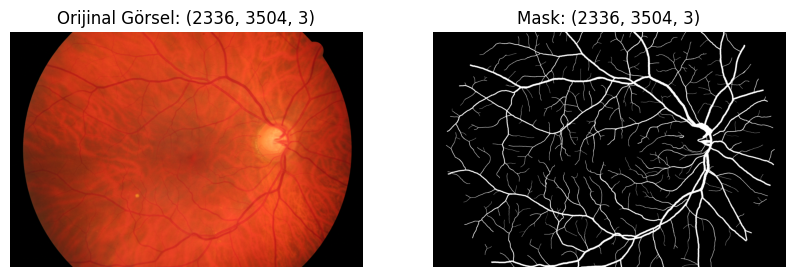

In [9]:
# Görüntüleri yükle
image = cv2.imread("/kaggle/working/HRF-Data/Images/11_g.png")
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
mask = cv2.imread("/kaggle/working/HRF-Data/Mask/11_g.png")

plt.figure(figsize=(10,6))

# İlk görüntü
plt.subplot(1,2,1)
plt.imshow(image_rgb)
plt.title(f"Orijinal Görsel: {image_rgb.shape}")
plt.axis('off')  # Eksenleri kapat

# İkinci görüntü (mask)
plt.subplot(1,2,2)
plt.imshow(mask, cmap='gray')
plt.title(f"Mask: {mask.shape}")
plt.axis('off')  # Eksenleri kapat

plt.show()

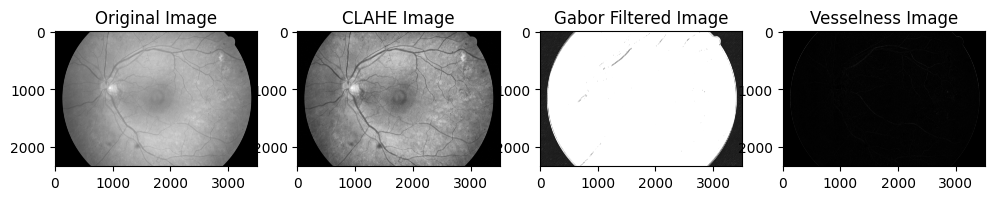

In [10]:
# Orijinal görseli yükle
image = cv2.imread('/kaggle/working/HRF-Data/Images/12_dr.png', cv2.IMREAD_GRAYSCALE)

# CLAHE uygula
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
clahe_image = clahe.apply(image)

# Gabor Filtresi uygula
g_kernel = cv2.getGaborKernel((21, 21), 8.0, np.pi/4, 10.0, 0.5, 0, ktype=cv2.CV_32F)
filtered_image = cv2.filter2D(clahe_image, cv2.CV_8UC3, g_kernel)

# Frangi Vesselness Filtresi
import skimage.filters
vesselness_image = skimage.filters.frangi(clahe_image)

# Görüntüleri göster
plt.figure(figsize=(12, 8))

plt.subplot(1, 4, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')

plt.subplot(1, 4, 2)
plt.imshow(clahe_image, cmap='gray')
plt.title('CLAHE Image')

plt.subplot(1, 4, 3)
plt.imshow(filtered_image, cmap='gray')
plt.title('Gabor Filtered Image')

plt.subplot(1, 4, 4)
plt.imshow(vesselness_image, cmap='gray')
plt.title('Vesselness Image')

plt.show()

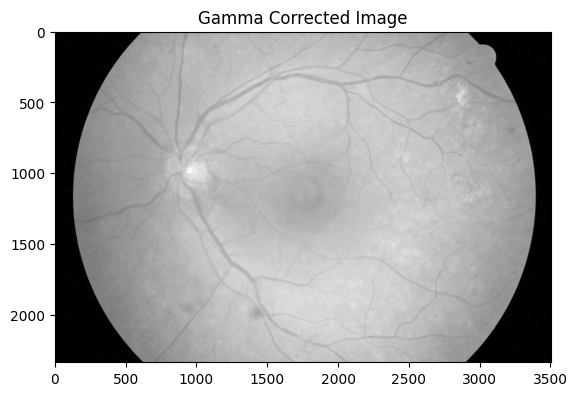

In [11]:
def adjust_gamma(image, gamma=1.0):
    invGamma = 1.0 / gamma
    table = np.array([(i / 255.0) ** invGamma * 255 for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(image, table)

image = cv2.imread('/kaggle/working/HRF-Data/Images/12_dr.png', cv2.IMREAD_GRAYSCALE)

# Gamma düzeltme uygulama
gamma_corrected_image = adjust_gamma(image, gamma=1.5)
plt.imshow(gamma_corrected_image, cmap='gray')
plt.title('Gamma Corrected Image')
plt.show()

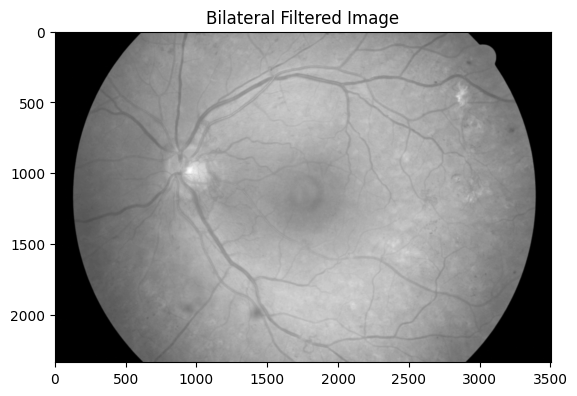

In [12]:
bilateral_filtered_image = cv2.bilateralFilter(image, d=9, sigmaColor=75, sigmaSpace=75)
plt.imshow(bilateral_filtered_image, cmap='gray')
plt.title('Bilateral Filtered Image')
plt.show()

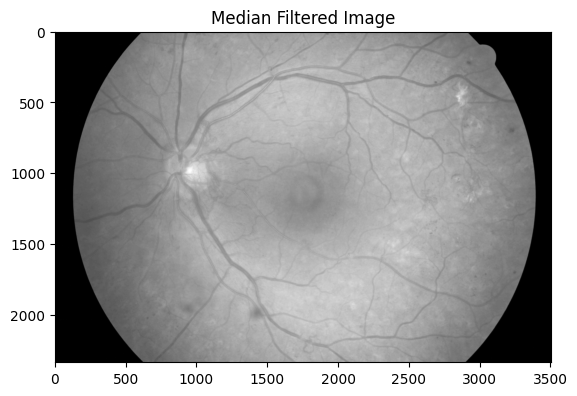

In [13]:
median_filtered_image = cv2.medianBlur(image, 5)
plt.imshow(median_filtered_image, cmap='gray')
plt.title('Median Filtered Image')
plt.show()

Text(0.5, 1.0, 'CLAHE Uygulandı')

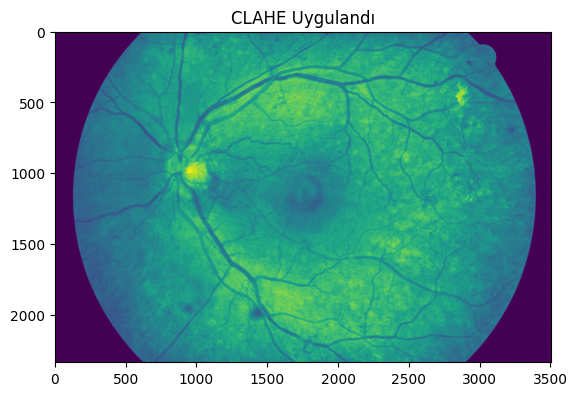

In [14]:
# CLAHE uygulama
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
clahe_image = clahe.apply(image)

plt.imshow(clahe_image)
plt.title('CLAHE Uygulandı')

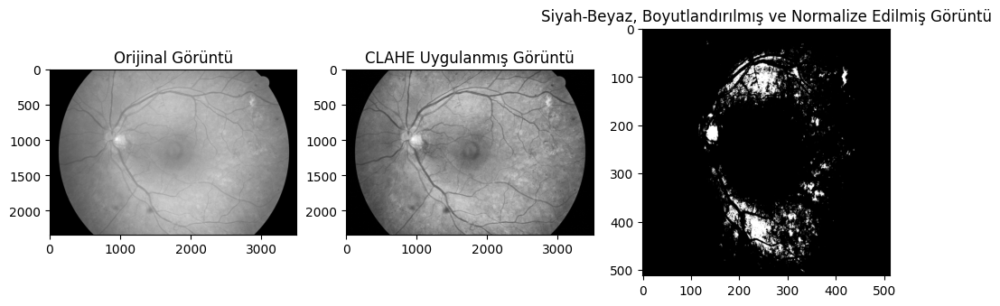

In [11]:
# Orijinal görüntüyü yükleme
image = cv2.imread('/kaggle/working/HRF-Data/Images/12_dr.png', cv2.IMREAD_GRAYSCALE)

# CLAHE uygulama
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
clahe_image = clahe.apply(image)

# Görüntüyü siyah-beyaz yapma (thresholding)
_, binary_image = cv2.threshold(clahe_image, 128, 255, cv2.THRESH_BINARY)

# Görüntüyü model için uygun boyuta yeniden boyutlandırma
target_size = (512, 512)
resized_image = cv2.resize(binary_image, target_size, interpolation=cv2.INTER_AREA)

# Normalizasyon (0-1 aralığına getirme)
normalized_image = resized_image / 255.0

# Görüntüyü gösterme
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(image, cmap='gray')
plt.title('Orijinal Görüntü')

plt.subplot(1, 3, 2)
plt.imshow(clahe_image, cmap='gray')
plt.title('CLAHE Uygulanmış Görüntü')

plt.subplot(1, 3, 3)
plt.imshow(normalized_image, cmap='gray')
plt.title('Siyah-Beyaz, Boyutlandırılmış ve Normalize Edilmiş Görüntü')

plt.show()

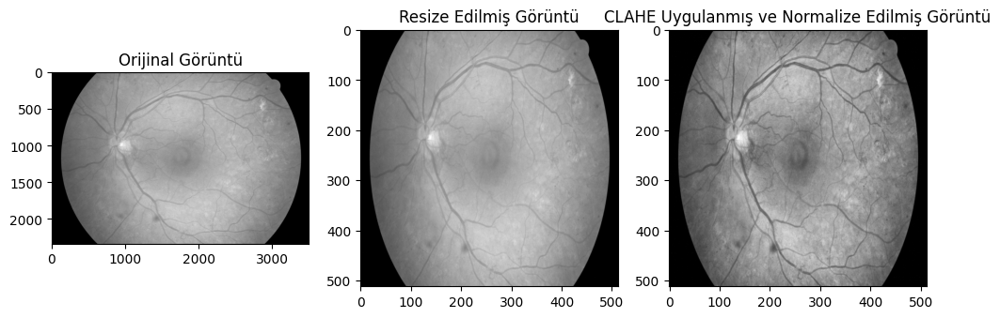

In [12]:
# Orijinal görüntüyü yükle
image = cv2.imread('/kaggle/working/HRF-Data/Images/12_dr.png', cv2.IMREAD_GRAYSCALE)

# Görüntüyü model için uygun boyuta yeniden boyutlandırma
target_size = (512, 512)
resized_image = cv2.resize(image, target_size, interpolation=cv2.INTER_AREA)

# CLAHE uygulama
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
clahe_image = clahe.apply(resized_image)

# Normalizasyon (0-1 aralığına getirme)
normalized_image = clahe_image / 255.0

# Görüntüyü gösterme
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(image, cmap='gray')
plt.title('Orijinal Görüntü')

plt.subplot(1, 3, 2)
plt.imshow(resized_image, cmap='gray')
plt.title('Resize Edilmiş Görüntü')

plt.subplot(1, 3, 3)
plt.imshow(normalized_image, cmap='gray')
plt.title('CLAHE Uygulanmış ve Normalize Edilmiş Görüntü')

plt.show()

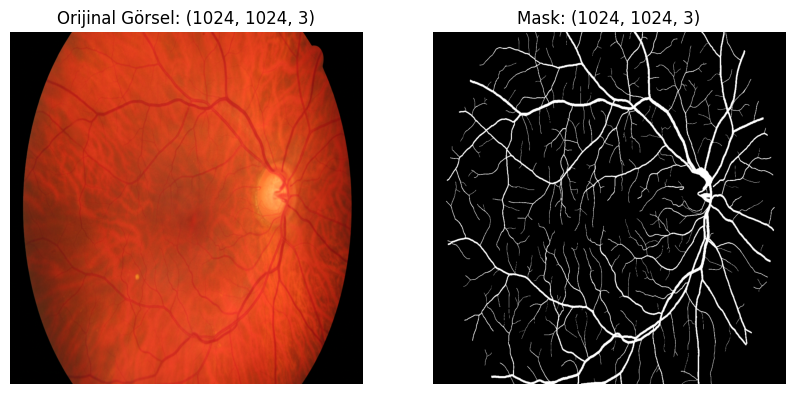

In [13]:
resized_image = cv2.resize(image_rgb, (1024,1024))
resized_mask = cv2.resize(mask, (1024,1024))

plt.figure(figsize=(10,6))

# İlk görüntü
plt.subplot(1,2,1)
plt.imshow(resized_image)
plt.title(f"Orijinal Görsel: {resized_image.shape}")
plt.axis('off')  # Eksenleri kapat

# İkinci görüntü (mask)
plt.subplot(1,2,2)
plt.imshow(resized_mask, cmap='gray')
plt.title(f"Mask: {resized_mask.shape}")
plt.axis('off')  # Eksenleri kapat

plt.show()

In [14]:
# CHASEDB

chasedb_images = []
chasedb_mask = []

chasedb_images_dir = glob("/kaggle/working/Chasedb-Data/Images/*.png")
chasedb_mask_dir = glob("/kaggle/working/Chasedb-Data/Mask/*.png")

for image in chasedb_images_dir:
    chasedb_images.append(image)

for mask in chasedb_mask_dir:
    chasedb_mask.append(mask)

# Görsel ve maske sayısını ekrana yazdır
print(f"Toplam görsel sayısı: {len(chasedb_images)}")
print(f"Toplam maske sayısı: {len(chasedb_mask)}")

Toplam görsel sayısı: 28
Toplam maske sayısı: 56


In [15]:
# FIVES

fivesdata_images = []
fivesdata_mask = []

fivesdata_images_dir = glob("/kaggle/working/Fives-Data/Images/*.png")
fivesdata_mask_dir = glob("/kaggle/working/Fives-Data/Mask/*.png")

for image in fivesdata_images_dir:
    fivesdata_images.append(image)

for mask in fivesdata_mask_dir:
    fivesdata_mask.append(mask)
    
# Görsel ve maske sayısını ekrana yazdır
print(f"Toplam görsel sayısı: {len(fivesdata_images)}")
print(f"Toplam maske sayısı: {len(fivesdata_mask)}")

Toplam görsel sayısı: 750
Toplam maske sayısı: 750


In [16]:
# HRF

hrf_images = []
hrf_mask = []

hrf_images_dir = glob("/kaggle/working/HRF-Data/Images/*.png")
hrf_mask_dir = glob("/kaggle/working/HRF-Data/Mask/*.png")

for image in hrf_images_dir:
    hrf_images.append(image)

for mask in hrf_mask_dir:
    hrf_mask.append(mask)
    
# Görsel ve maske sayısını ekrana yazdır
print(f"Toplam görsel sayısı: {len(hrf_images)}")
print(f"Toplam maske sayısı: {len(hrf_mask)}")

Toplam görsel sayısı: 45
Toplam maske sayısı: 45


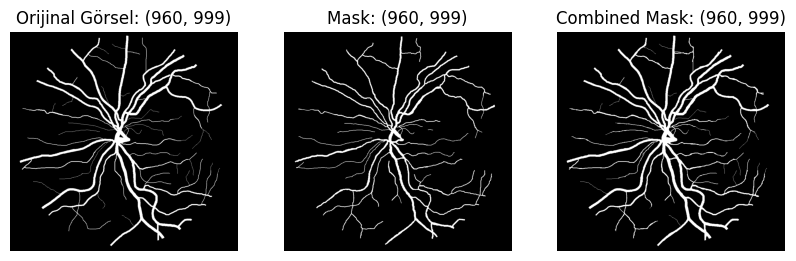

In [17]:
Path('/kaggle/working/Deneme/').mkdir(parents=True, exist_ok=True)

# İki maskeyi yükleyin
mask1 = cv2.imread("/kaggle/working/Chasedb-Data/Mask/Image_03L_1stHO.png", cv2.IMREAD_GRAYSCALE)
mask2 = cv2.imread("/kaggle/working/Chasedb-Data/Mask/Image_03L_2ndHO.png", cv2.IMREAD_GRAYSCALE)

plt.figure(figsize=(10,6))

# İlk görüntü
plt.subplot(1,3,1)
plt.imshow(mask1, cmap='gray')
plt.title(f"Orijinal Görsel: {mask2.shape}")
plt.axis('off')  # Eksenleri kapat

# İkinci görüntü (mask)
plt.subplot(1,3,2)
plt.imshow(mask2, cmap='gray')
plt.title(f"Mask: {mask2.shape}")
plt.axis('off')  # Eksenleri kapat

# İki maskeyi birleştirin (mantıksal OR işlemi)
combined_mask = cv2.bitwise_or(mask1, mask2)

# Birleştirilen maskeyi kaydedin veya görselleştirin
cv2.imwrite("/kaggle/working/Deneme/combined_mask.png", combined_mask)

image = Image.open("/kaggle/working/Deneme/combined_mask.png")

combined_image = cv2.imread("/kaggle/working/Deneme/combined_mask.png", cv2.IMREAD_GRAYSCALE)

plt.subplot(1,3,3)
plt.imshow(combined_image, cmap='gray')
plt.title(f"Combined Mask: {combined_image.shape}")
plt.axis('off')  # Eksenleri kapat
plt.show()

In [18]:
# Maskelerin birleştirileceği dizin
output_dir = '/kaggle/working/Chasedb-Data/Combined_Mask/'
Path(output_dir).mkdir(parents=True, exist_ok=True)
     
chasedb_mask_dir = glob("/kaggle/working/Chasedb-Data/Mask/*.png")

# Maskeleri eşleştirme ve birleştirme
for i, path1 in enumerate(chasedb_mask_dir):
    # Ortak kısmı (örneğin, Image_03L) elde et
    common_part1 = "_".join(os.path.basename(path1).split('_')[:2])
    #print(f"common_part1: {common_part1}")
    
    for path2 in chasedb_mask_dir[i+1:]:
        common_part2 = "_".join(os.path.basename(path2).split('_')[:2])
        #print(f"common_part2: {common_part2}")

        # Eğer iki maske aynı ortak kısma sahipse birleştir
        if common_part1 == common_part2:
            # Maskeleri yükle
            mask1 = cv2.imread(path1, cv2.IMREAD_GRAYSCALE)
            mask2 = cv2.imread(path2, cv2.IMREAD_GRAYSCALE)
            
            # Maskeleri birleştir (mantıksal OR işlemi)
            combined_mask = cv2.bitwise_or(mask1, mask2)
            
            # Yeni dosya adı oluştur (örneğin, Image_03L_combined.png)
            combined_filename = f"{common_part1}_combined.png"
            combined_path = os.path.join(output_dir, combined_filename)
            
            # Birleştirilen maskeyi kaydet
            cv2.imwrite(combined_path, combined_mask)
            print(f"{combined_filename} oluşturuldu ve {combined_path} yoluna kaydedildi.")
            
            # Birleştirilen maskeyi görselleştir
            #image = Image.open(combined_path)
            #plt.imshow(image, cmap='gray')
            #plt.show()
            
            # Birleştirdikten sonra bu iki dosyayı işlenmiş olarak işaretle
            break  # Bu eşleştirmeyle ilgili diğer döngüden çık

Image_13L_combined.png oluşturuldu ve /kaggle/working/Chasedb-Data/Combined_Mask/Image_13L_combined.png yoluna kaydedildi.
Image_08L_combined.png oluşturuldu ve /kaggle/working/Chasedb-Data/Combined_Mask/Image_08L_combined.png yoluna kaydedildi.
Image_11L_combined.png oluşturuldu ve /kaggle/working/Chasedb-Data/Combined_Mask/Image_11L_combined.png yoluna kaydedildi.
Image_13R_combined.png oluşturuldu ve /kaggle/working/Chasedb-Data/Combined_Mask/Image_13R_combined.png yoluna kaydedildi.
Image_09R_combined.png oluşturuldu ve /kaggle/working/Chasedb-Data/Combined_Mask/Image_09R_combined.png yoluna kaydedildi.
Image_10L_combined.png oluşturuldu ve /kaggle/working/Chasedb-Data/Combined_Mask/Image_10L_combined.png yoluna kaydedildi.
Image_08R_combined.png oluşturuldu ve /kaggle/working/Chasedb-Data/Combined_Mask/Image_08R_combined.png yoluna kaydedildi.
Image_10R_combined.png oluşturuldu ve /kaggle/working/Chasedb-Data/Combined_Mask/Image_10R_combined.png yoluna kaydedildi.
Image_06L_combin

In [19]:
# CHASEDB - combined mask

chasedb_combined_mask = []

chasedb_combined_mask_dir = glob("/kaggle/working/Chasedb-Data/Combined_Mask/*.png")

for mask in chasedb_combined_mask_dir:
    chasedb_combined_mask.append(mask)

# maske sayısını ekrana yazdır
print(f"Toplam maske sayısı: {len(chasedb_combined_mask)}")

Toplam maske sayısı: 28


In [28]:
print(chasedb_combined_mask[2])
plt.show()

/kaggle/working/Chasedb-Data/Combined_Mask/Image_06R_combined.png


In [20]:
# Hedef boyut
target_size = (512, 512)
# Listeler oluşturma
images = []
masks = []

# CLAHE işlemi için ayarlar
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))

# FIVES veri seti için görseller ve maskeleri listelere ekle
for image_path in fivesdata_images:
    img_name = os.path.splitext(os.path.basename(image_path))[0]
    
    # Maskeyi bul
    mask_path = next((mask for mask in fivesdata_mask if os.path.splitext(os.path.basename(mask))[0] == img_name), None)
    
    if mask_path:
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        resized_image = cv2.resize(image, target_size, interpolation=cv2.INTER_AREA)
        
        # CLAHE uygulama
        clahe_image = clahe.apply(resized_image)
        
        # Normalizasyon
        normalized_image = clahe_image / 255.0
        
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        resized_mask = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        resized_mask = resized_mask / 255.0  # Normalizasyon
        
        # Görsel ve maskeyi listelere ekle
        images.append(normalized_image)
        masks.append(resized_mask)

# CHASEDB veri seti için görseller ve maskeleri listelere ekle
for image_path in chasedb_images:
    img_name = os.path.splitext(os.path.basename(image_path))[0]
    
    # Maskeyi bul
    mask_path = next((mask for mask in chasedb_combined_mask if os.path.splitext(os.path.basename(mask))[0].replace('_combined', '') == img_name), None)
    
    if mask_path:
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        resized_image = cv2.resize(image, target_size, interpolation=cv2.INTER_AREA)
        
        # CLAHE uygulama
        clahe_image = clahe.apply(resized_image)
        
        # Normalizasyon
        normalized_image = clahe_image / 255.0
        
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        resized_mask = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        resized_mask = resized_mask / 255.0  # Normalizasyon
        
        # Görsel ve maskeyi listelere ekle
        images.append(normalized_image)
        masks.append(resized_mask)

# HRF veri seti için görseller ve maskeleri listelere ekle
for image_path in hrf_images:
    img_name = os.path.splitext(os.path.basename(image_path))[0]
    
    # Maskeyi bul
    mask_path = next((mask for mask in hrf_mask if os.path.splitext(os.path.basename(mask))[0] == img_name), None)
    
    if mask_path:
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        resized_image = cv2.resize(image, target_size, interpolation=cv2.INTER_AREA)
        
        # CLAHE uygulama
        clahe_image = clahe.apply(resized_image)
        
        # Normalizasyon
        normalized_image = clahe_image / 255.0
        
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        resized_mask = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        resized_mask = resized_mask / 255.0  # Normalizasyon
        
        # Görsel ve maskeyi listelere ekle
        images.append(normalized_image)
        masks.append(resized_mask)

# Listeleri NumPy dizilerine dönüştürme
X = np.array(images)
y = np.array(masks)

print(f"Görsel Seti Boyutu: {X.shape}")
print(f"Maske Seti Boyutu: {y.shape}")

Görsel Seti Boyutu: (823, 512, 512)
Maske Seti Boyutu: (823, 512, 512)


#
hrf_images = []
hrf_mask = []
fivesdata_images = []
fivesdata_mask = []
chasedb_images = []
chasedb_combined_mask = []


In [21]:
# Veriyi eğitim ve doğrulama setlerine ayırma
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Eğitim Seti Boyutu: {X_train.shape}")
print(f"Doğrulama Seti Boyutu: {X_val.shape}")

Eğitim Seti Boyutu: (658, 512, 512)
Doğrulama Seti Boyutu: (165, 512, 512)


In [23]:
def minimalistic_unet(input_shape, f0=16, k=3):
    inputs = tf.keras.Input(input_shape)

    # Encoder
    convs = []
    x = inputs
    for i in range(k):
        x = layers.Conv2D(f0 * (2**i), (3, 3), activation='relu', padding='same')(x)
        x = layers.BatchNormalization()(x)
        x = layers.Conv2D(f0 * (2**i), (3, 3), activation='relu', padding='same')(x)
        x = layers.BatchNormalization()(x)
        convs.append(x)
        x = layers.MaxPooling2D((2, 2))(x)
    
    # Bottleneck
    x = layers.Conv2D(f0 * (2**k), (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Conv2D(f0 * (2**k), (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)

    # Decoder
    for i in range(k-1, -1, -1):
        x = layers.Conv2DTranspose(f0 * (2**i), (2, 2), strides=(2, 2), padding='same')(x)
        x = layers.concatenate([x, convs[i]])
        x = layers.Conv2D(f0 * (2**i), (3, 3), activation='relu', padding='same')(x)
        x = layers.BatchNormalization()(x)
        x = layers.Conv2D(f0 * (2**i), (3, 3), activation='relu', padding='same')(x)
        x = layers.BatchNormalization()(x)
    
    outputs = layers.Conv2D(1, (1, 1), activation='sigmoid')(x)

    model = tf.keras.Model(inputs, outputs)
    return model

In [24]:
model = minimalistic_unet((128, 128, 3))

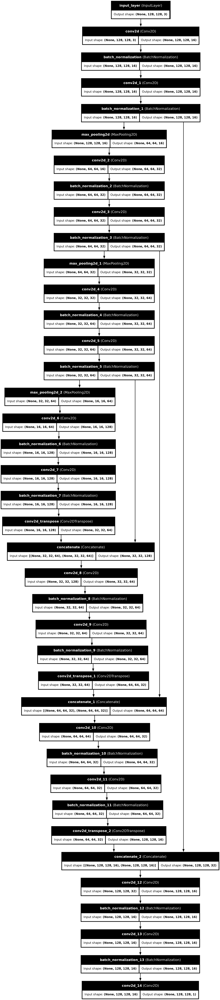

In [6]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file="unet_model.png", show_shapes=True, show_layer_names=True)


In [ ]:
# Modelin şemasını çiz ve kaydet
plot_model(model, to_file="unet_model.png", show_shapes=True, show_layer_names=True)

In [70]:
input_shape = (512, 512, 1)
model = minimalistic_unet(input_shape)
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 512, 512,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_22 (Conv2D)  │ (None, 512, 512,  │        160 │ input_layer_2[0]… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 512, 512,  │         64 │ conv2d_22[0][0]   │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_23 (Conv2D)  │ (None, 512, 512,  │      2,320 │ batch_normalizat… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 512, 512,  │         64 │ conv2d_23[0][0]   │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_24 (Conv2D)  │ (None, 256, 256,  │      4,640 │ max_pooling2d_4[… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        128 │ conv2d_24[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_25 (Conv2D)  │ (None, 256, 256,  │      9,248 │ batch_normalizat… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        128 │ conv2d_25[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_5     │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_26 (Conv2D)  │ (None, 128, 128,  │     18,496 │ max_pooling2d_5[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        256 │ conv2d_26[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_27 (Conv2D)  │ (None, 128, 128,  │     36,928 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        256 │ conv2d_27[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_6     │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_28 (Conv2D)  │ (None, 64, 64,    │     73,856 │ max_pooling2d_6[

 Total params: 484,561 (1.85 MB)

 Trainable params: 483,153 (1.84 MB)

 Non-trainable params: 1,408 (5.50 KB)

In [71]:
# Modeli eğitme
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=16)

Epoch 1/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 56s 549ms/step - accuracy: 0.6235 - loss: 0.7173 - val_accuracy: 0.9256 - val_loss: 0.5481
Epoch 2/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9302 - loss: 0.4452 - val_accuracy: 0.9256 - val_loss: 0.3574
Epoch 3/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9623 - loss: 0.3116 - val_accuracy: 0.9256 - val_loss: 0.2772
Epoch 4/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9702 - loss: 0.2303 - val_accuracy: 0.9256 - val_loss: 0.2675
Epoch 5/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9747 - loss: 0.1725 - val_accuracy: 0.9248 - val_loss: 0.2758
Epoch 6/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 229ms/step - accuracy: 0.9772 - loss: 0.1359 - val_accuracy: 0.9252 - val_loss: 0.2862
Epoch 7/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9791 - loss: 0.1093 - val_accuracy: 0.9276 - val_loss: 0.2757
Epoch 8/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9793 - loss: 0.0955 - val_accu

In [25]:
def focal_loss(alpha, gamma):
    def focal_loss_fixed(y_true, y_pred):
        y_true = K.flatten(y_true)
        y_pred = K.flatten(y_pred)
        
        # Binary Crossentropy
        bce = K.binary_crossentropy(y_true, y_pred)
        
        # Focal Loss
        loss = alpha * K.pow(1 - K.exp(-bce), gamma) * bce
        
        return K.mean(loss)
    
    return focal_loss_fixed

In [44]:
from tensorflow.keras.callbacks import ReduceLROnPlateau

# Zamanla azalan öğrenme oranı callback'i
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6, verbose=1)

input_shape = (512, 512, 1)
model = minimalistic_unet(input_shape)
model.compile(optimizer='adam', loss=focal_loss(alpha=0.1, gamma=1.0), metrics=['accuracy'])
model.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 512, 512,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_30 (Conv2D)  │ (None, 512, 512,  │        160 │ input_layer_2[0]… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 512, 512,  │         64 │ conv2d_30[0][0]   │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_31 (Conv2D)  │ (None, 512, 512,  │      2,320 │ batch_normalizat… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 512, 512,  │         64 │ conv2d_31[0][0]   │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_6     │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_32 (Conv2D)  │ (None, 256, 256,  │      4,640 │ max_pooling2d_6[… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        128 │ conv2d_32[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_33 (Conv2D)  │ (None, 256, 256,  │      9,248 │ batch_normalizat… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        128 │ conv2d_33[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_7     │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_34 (Conv2D)  │ (None, 128, 128,  │     18,496 │ max_pooling2d_7[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        256 │ conv2d_34[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_35 (Conv2D)  │ (None, 128, 128,  │     36,928 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        256 │ conv2d_35[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_8     │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_36 (Conv2D)  │ (None, 64, 64,    │     73,856 │ max_pooling2d_8[

 Total params: 484,561 (1.85 MB)

 Trainable params: 483,153 (1.84 MB)

 Non-trainable params: 1,408 (5.50 KB)

In [45]:
# Modeli eğitme - focal loss
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=16, callbacks=[reduce_lr])

Epoch 1/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 30s 396ms/step - accuracy: 0.6387 - loss: 0.0352 - val_accuracy: 0.9263 - val_loss: 0.0293 - learning_rate: 0.0010
Epoch 2/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9124 - loss: 0.0218 - val_accuracy: 0.9263 - val_loss: 0.0194 - learning_rate: 0.0010
Epoch 3/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9516 - loss: 0.0148 - val_accuracy: 0.9263 - val_loss: 0.0139 - learning_rate: 0.0010
Epoch 4/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9635 - loss: 0.0095 - val_accuracy: 0.9263 - val_loss: 0.0144 - learning_rate: 0.0010
Epoch 5/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9700 - loss: 0.0068 - val_accuracy: 0.9263 - val_loss: 0.0162 - learning_rate: 0.0010
Epoch 6/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 228ms/step - accuracy: 0.9736 - loss: 0.0054 - val_accuracy: 0.9261 - val_loss: 0.0175 - learning_rate: 0.0010
Epoch 7/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 229ms/step - accuracy: 0.9756 - loss: 0.

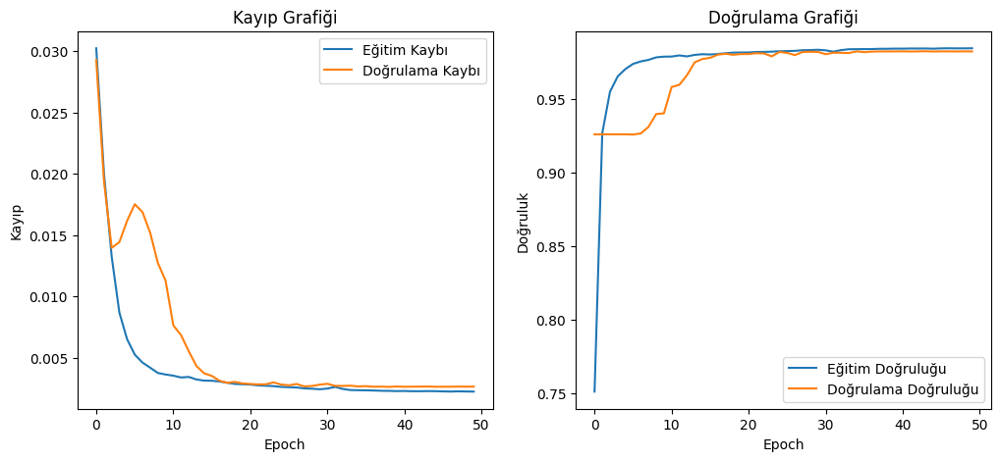

In [46]:
plt.figure(figsize=(12,5))

plt.subplot(1,2,1)
# Eğitim ve doğrulama kaybını çizdirme
plt.title("Kayıp Grafiği")
plt.plot(history.history['loss'], label='Eğitim Kaybı')
plt.plot(history.history['val_loss'], label='Doğrulama Kaybı')
plt.xlabel('Epoch')
plt.ylabel('Kayıp')
plt.legend()

plt.subplot(1,2,2)
# Eğitim ve doğrulama doğruluğunu çizdirme
plt.title("Doğrulama Grafiği")
plt.plot(history.history['accuracy'], label='Eğitim Doğruluğu')
plt.plot(history.history['val_accuracy'], label='Doğrulama Doğruluğu')
plt.xlabel('Epoch')
plt.ylabel('Doğruluk')
plt.legend()
plt.show()

In [92]:
# Modeli kaydetme
model.save('/kaggle/working/minimalistic_unet_model_3_v2.h5')

In [47]:
test_images_paths = glob("/kaggle/input/retina-blood-vessel/Data/test/image/*.png")
test_masks_paths = glob("/kaggle/input/retina-blood-vessel/Data/test/mask/*.png")

# Test verileri için boş listeler
X_test = []
y_test = []

# Test verilerini yükleyin
for image_path, mask_path in zip(test_images_paths, test_masks_paths):
    # Görseli yükle ve yeniden boyutlandır
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Gri tonlama olarak yükle
    resized_image = cv2.resize(image, (512, 512), interpolation=cv2.INTER_AREA)
    
    # CLAHE uygula
    clahe_image = clahe.apply(resized_image)
    
    # Normalizasyon
    normalized_image = clahe_image / 255.0
    X_test.append(normalized_image)
    
    # Maskeyi yükle ve yeniden boyutlandır
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    resized_mask = cv2.resize(mask, (512, 512), interpolation=cv2.INTER_NEAREST)
    resized_mask = resized_mask / 255.0  # Normalizasyon
    y_test.append(resized_mask)

# Listeleri NumPy dizilerine dönüştürme
X_test = np.array(X_test)
y_test = np.array(y_test)

In [48]:
print(f"Test Görsel Seti Boyutu: {X_test.shape}")
print(f"Test Maske Seti Boyutu: {y_test.shape}")

Test Görsel Seti Boyutu: (20, 512, 512)
Test Maske Seti Boyutu: (20, 512, 512)


In [49]:
# Test seti üzerindeki tahminler
predictions = model.predict(X_test)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 727ms/step


In [50]:
import numpy as np
from sklearn.metrics import confusion_matrix

# Dice Coefficient
def dice_coefficient(y_true, y_pred):
    intersection = np.sum(np.abs(y_true * y_pred))
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + 1e-7)

# IoU (Intersection over Union)
def iou_metric(y_true, y_pred):
    intersection = np.sum(np.abs(y_true * y_pred))
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return intersection / (union + 1e-7)

# Precision
def precision(y_true, y_pred):
    true_positives = np.sum(y_true * y_pred)
    predicted_positives = np.sum(y_pred)
    return true_positives / (predicted_positives + 1e-7)

# Recall (Sensitivity)
def recall(y_true, y_pred):
    true_positives = np.sum(y_true * y_pred)
    possible_positives = np.sum(y_true)
    return true_positives / (possible_positives + 1e-7)

# Specificity
def specificity(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true.flatten(), y_pred.flatten()).ravel()
    return tn / (tn + fp + 1e-7)

In [51]:
# Tahminleri binarize etme (0.5 eşik değeri kullanarak)
y_pred_binary = (predictions > 0.5).astype(np.uint8)
y_true_binary = (y_test > 0.5).astype(np.uint8)  # y_test gerçek etiketler


In [52]:
import numpy as np
from sklearn.metrics import roc_auc_score

# Gerçek segmentasyon maskesi (binary) ve tahmin edilen maskeler
y_true = np.ravel(y_true_binary)  # 2D maskeyi 1D'ye çevirme
y_pred_proba = np.ravel(y_pred_binary)  # 2D tahmin maskesini 1D'ye çevirme

# AUC hesaplama
auc_value = roc_auc_score(y_true, y_pred_proba)

print(f"Segmentasyon için AUC değeri: {auc_value}")

Segmentasyon için AUC değeri: 0.8164078492934984


In [38]:
# Tahminleri binarize etme (0.5 eşik değeri kullanarak)
y_pred_binary = np.squeeze((predictions > 0.5).astype(np.uint8))  # Fazladan boyutu sıkıştır
y_true_binary = (y_test > 0.5).astype(np.uint8)  # y_test gerçek etiketler

# Şimdi metrikleri hesaplayabiliriz:
# IoU
iou = iou_metric(y_true_binary, y_pred_binary)
print(f"IoU: {iou:.4f}")

# Dice Coefficient
dice = dice_coefficient(y_true_binary, y_pred_binary)
print(f"Dice Coefficient: {dice:.4f}")

# Precision
prec = precision(y_true_binary, y_pred_binary)
print(f"Precision: {prec:.4f}")

# Recall (Sensitivity)
rec = recall(y_true_binary, y_pred_binary)
print(f"Recall (Sensitivity): {rec:.4f}")

# Specificity
spec = specificity(y_true_binary, y_pred_binary)
print(f"Specificity: {spec:.4f}")

IoU: 0.5823
Dice Coefficient: 0.7360
Precision: 0.8238
Recall (Sensitivity): 0.6651
Specificity: 0.9864


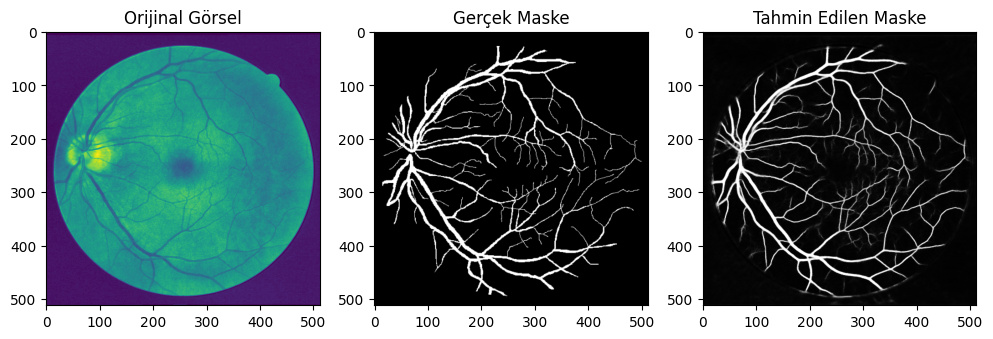

In [39]:
# İlk tahmini görselleştirme

plt.figure(figsize=(12, 6))

# Orijinal Görsel
plt.subplot(1, 3, 1)
plt.imshow(X_test[0])
plt.title('Orijinal Görsel')

# Gerçek Maske
plt.subplot(1, 3, 2)
plt.imshow(y_test[0].squeeze(), cmap='gray')
plt.title('Gerçek Maske')

# Tahmin Edilen Maske
plt.subplot(1, 3, 3)
plt.imshow(predictions[0].squeeze(), cmap='gray')
plt.title('Tahmin Edilen Maske')

plt.show()

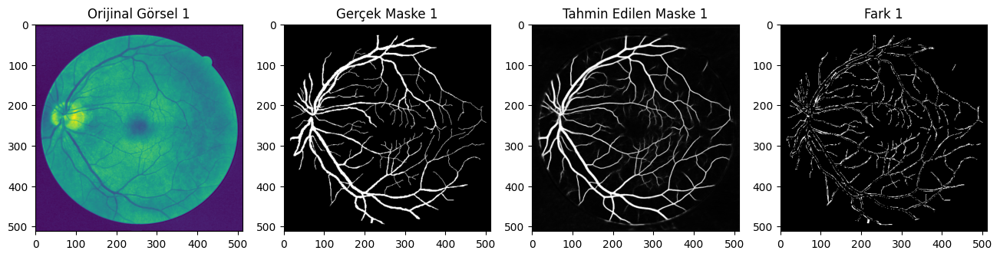

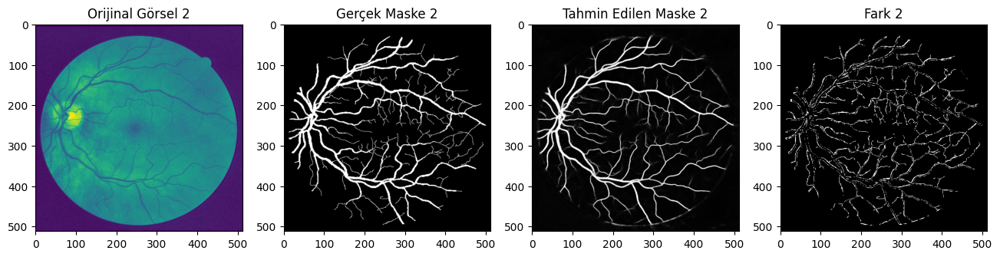

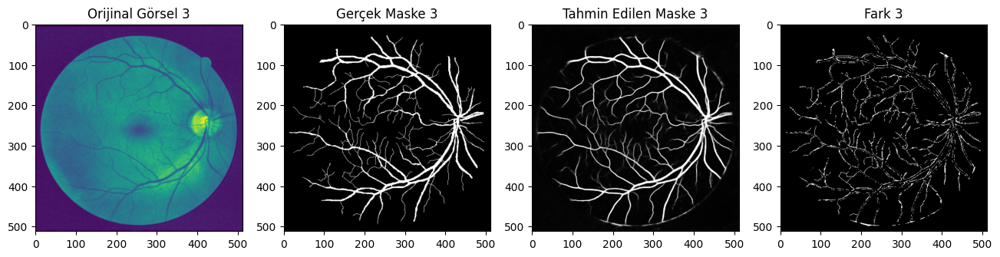

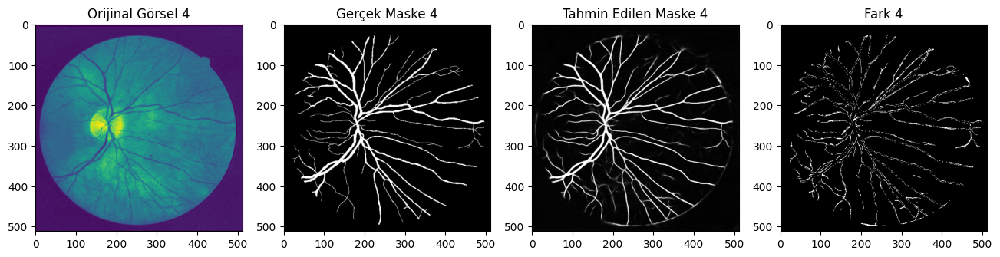

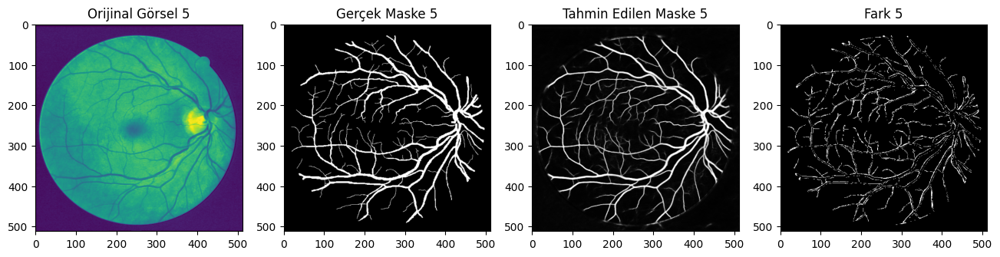

...

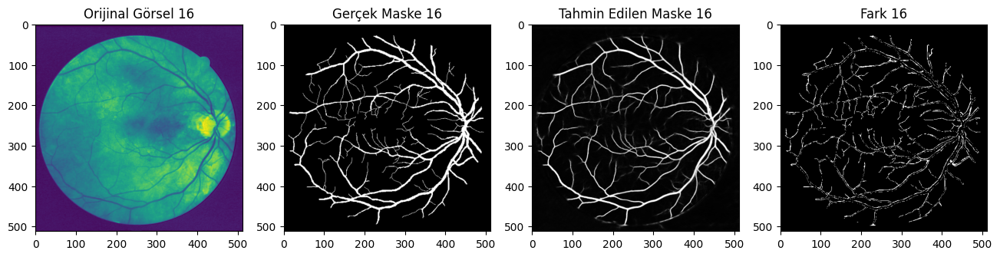

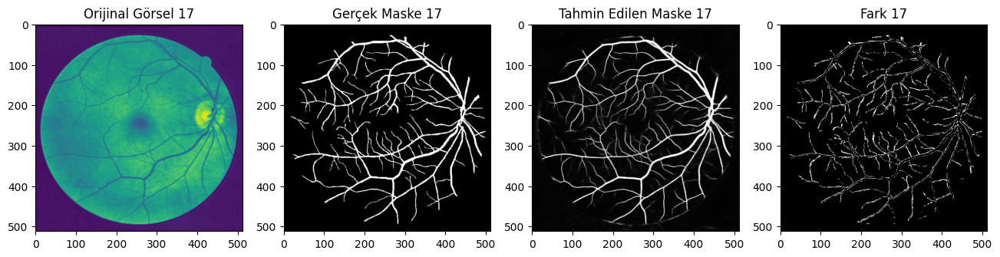

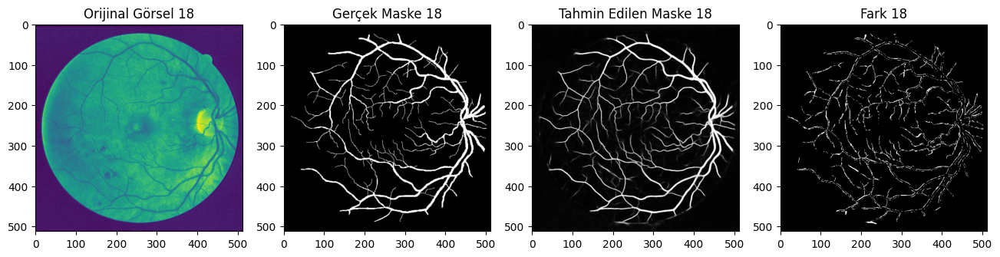

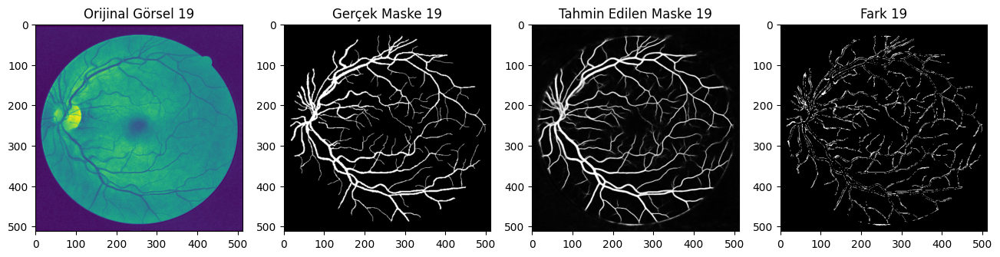

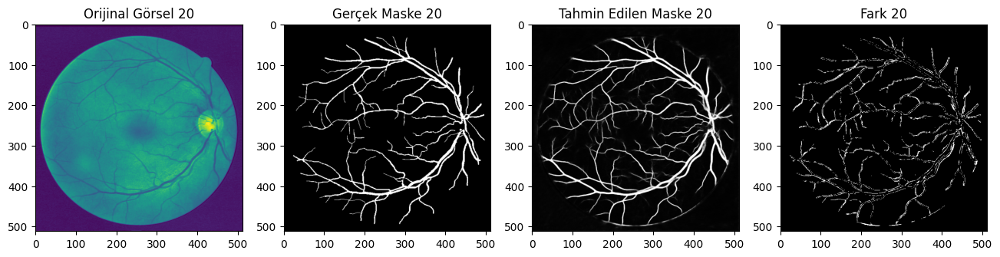

In [40]:
# Tüm test verilerini döngüyle görselleştirme
for i in range(len(X_test)):
    plt.figure(figsize=(16, 6))  # Daha geniş bir figür boyutu belirleyin
    
    # Orijinal Görsel (BGR -> RGB dönüşümü yaparak göster)
    plt.subplot(1, 4, 1)
    plt.imshow(X_test[i])
    plt.title(f'Orijinal Görsel {i+1}')
    
    # Gerçek Maske
    plt.subplot(1, 4, 2)
    plt.imshow(y_test[i].squeeze(), cmap='gray')
    plt.title(f'Gerçek Maske {i+1}')
    
    # Tahmin Edilen Maske
    predicted_mask = predictions[i].squeeze()
    plt.subplot(1, 4, 3)
    plt.imshow(predicted_mask, cmap='gray')
    plt.title(f'Tahmin Edilen Maske {i+1}')
    
    # Tahmin Edilen Maske ve Gerçek Maske Arasındaki Fark (XOR ile)
    difference = np.logical_xor(y_test[i].squeeze() > 0.5, predicted_mask > 0.5).astype(np.float32)
    plt.subplot(1, 4, 4)
    plt.imshow(difference, cmap='gray')  # Farkları siyah-beyaz olarak göster
    plt.title(f'Fark {i+1}')
    
    plt.show()

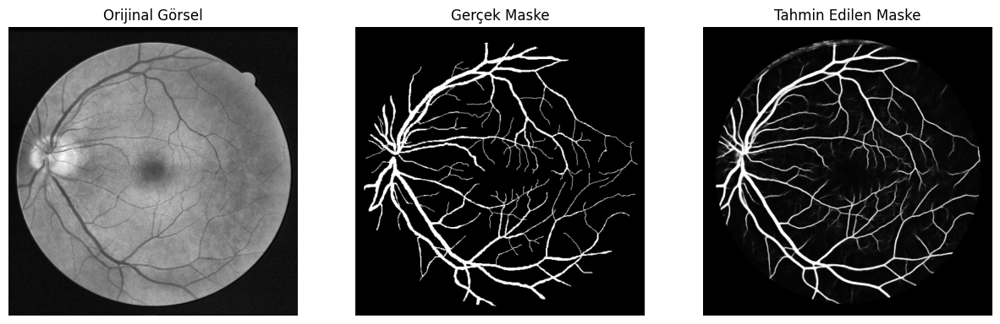

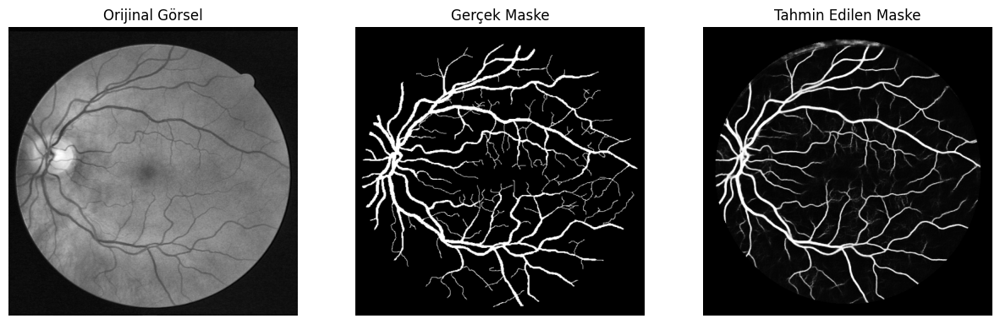

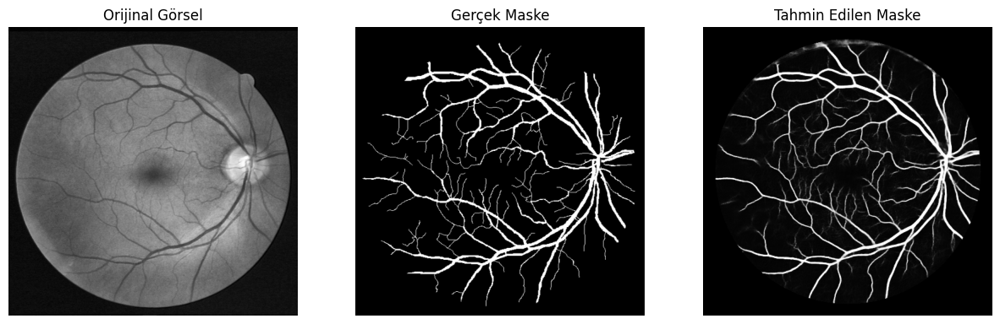

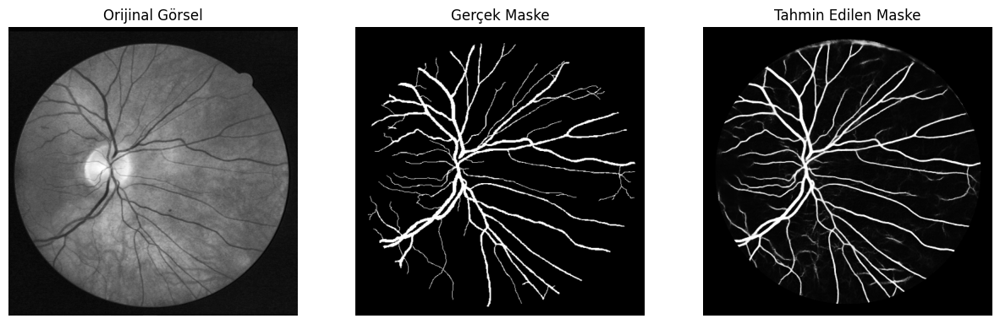

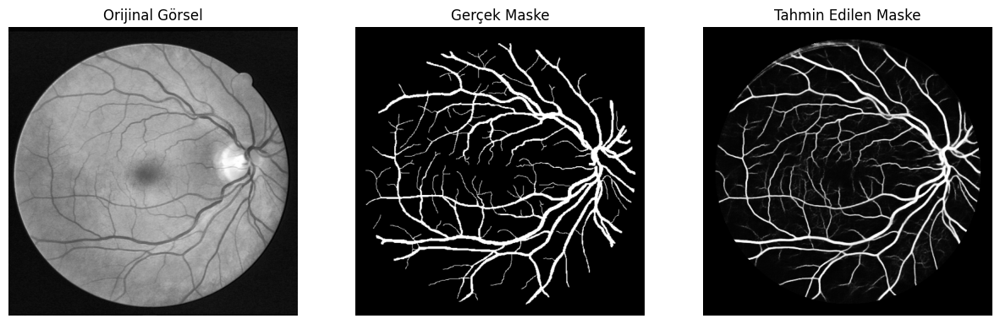

...

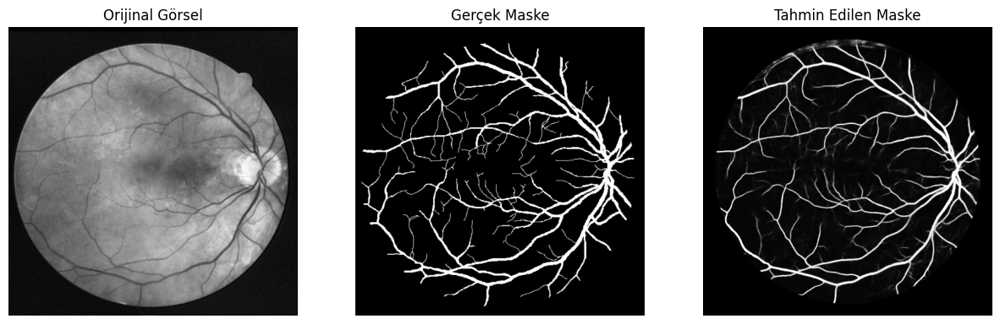

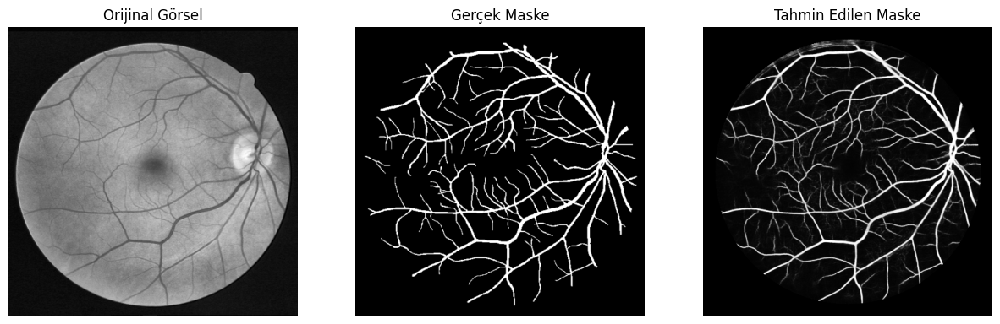

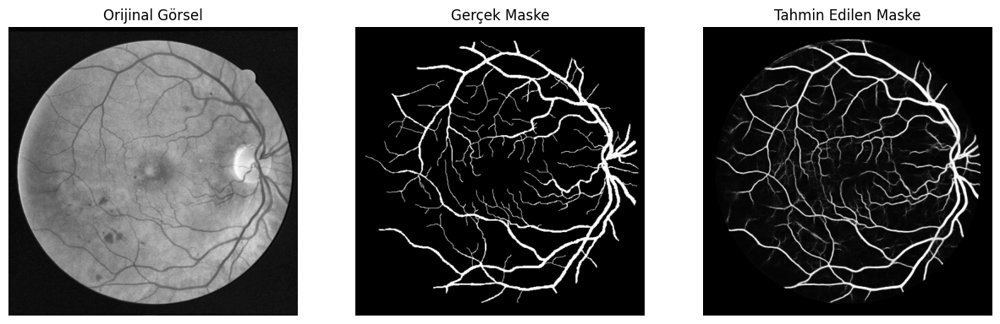

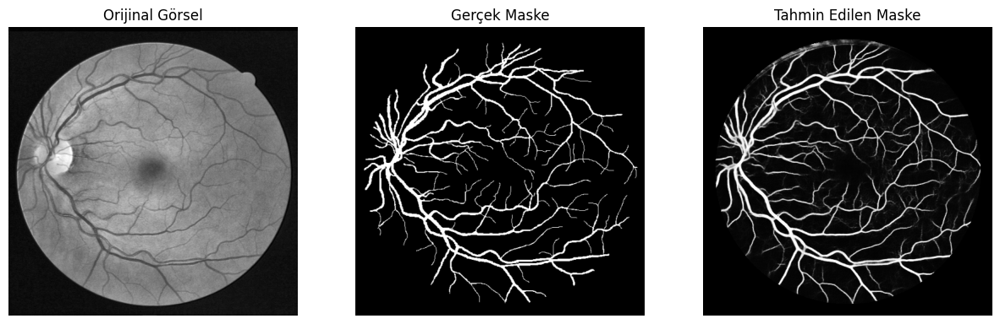

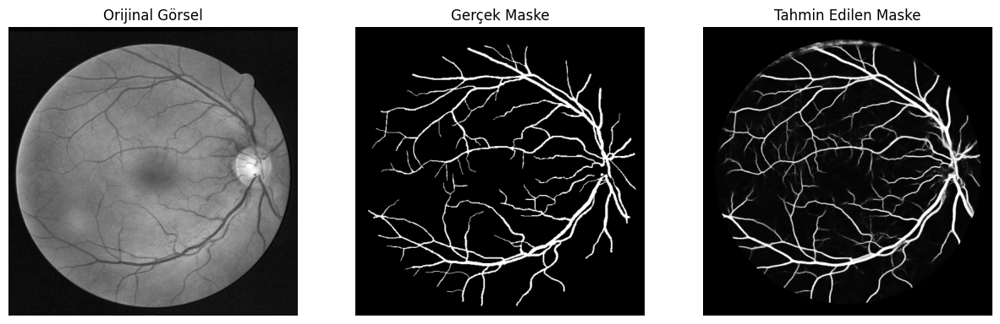

In [35]:
# Tüm tahmin edilen maskeler için döngü
for i in range(len(predictions)):
    # Orijinal tahmin edilen maskeyi alın ve sıkıştırın
    predicted_mask = predictions[i].squeeze()

    # Tahmin edilen maskenin boyutlarını alın
    mask_height, mask_width = predicted_mask.shape

    # Merkez ve yarıçapı tanımla, merkezi yukarı kaydır ve yarıçapı ayarla
    center = (mask_width // 2, int(mask_height * 0.50))
    radius = int(mask_width * 0.46)

    # Dairesel bir maske oluşturun
    circular_mask = np.zeros((mask_height, mask_width), dtype=np.uint8)
    cv2.circle(circular_mask, center, radius, 1, thickness=-1)

    # Tahmin edilen maske ile dairesel maskeyi çarp
    masked_prediction = cv2.bitwise_and(predicted_mask, predicted_mask, mask=circular_mask)

    # Sonucu görselleştirin
    plt.figure(figsize=(15, 5))

    # Orijinal Görsel
    plt.subplot(1, 3, 1)
    plt.imshow(X_test[i], cmap='gray')
    plt.title(f'Orijinal Görsel')
    plt.axis('off')

    # Gerçek Maske
    plt.subplot(1, 3, 2)
    plt.imshow(y_test[i].squeeze(), cmap='gray')
    plt.title(f'Gerçek Maske')
    plt.axis('off')

    # Dairesel Maske Uygulandıktan Sonra Tahmin Edilen Maske
    plt.subplot(1, 3, 3)
    plt.imshow(masked_prediction, cmap='gray')
    plt.title(f'Tahmin Edilen Maske')
    plt.axis('off')

    plt.show()

In [30]:
print(f"Test Görsel Seti Boyutu: {X_test.shape}")
print(f"Test Maske Seti Boyutu: {y_test.shape}")

Test Görsel Seti Boyutu: (20, 512, 512)
Test Maske Seti Boyutu: (20, 512, 512)


# SAM 

In [31]:
test_images = glob("/kaggle/input/retina-blood-vessel/Data/test/image/*.png")
test_masks = glob("/kaggle/input/retina-blood-vessel/Data/test/mask/*.png")

In [11]:
images = []
masks = []

for image_path in test_images:
    img = cv2.imread(image_path)
    images.append(img)
    
for mask_path in test_masks:
    mask = cv2.imread(mask_path)
    masks.append(mask)
    
# Listeleri NumPy dizilerine dönüştürme
images = np.array(images)
masks = np.array(masks)
    
print(f"Images shape: {images.shape}")
print(f"Masks shape: {masks.shape}")

Images shape: (20, 512, 512, 3)
Masks shape: (20, 512, 512, 3)


In [5]:
import torch
from segment_anything import sam_model_registry, SamPredictor

In [6]:
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_l_0b3195.pth -O /kaggle/working/sam_vit_l.pth


/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


--2024-08-30 08:16:38--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_l_0b3195.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 13.227.219.10, 13.227.219.59, 13.227.219.33, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|13.227.219.10|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1249524607 (1.2G) [binary/octet-stream]
Saving to: '/kaggle/working/sam_vit_l.pth'

/kaggle/working/sam 100%[===================>]   1.16G   295MB/s    in 4.0s    

2024-08-30 08:16:42 (297 MB/s) - '/kaggle/working/sam_vit_l.pth' saved [1249524607/1249524607]



In [7]:
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O /kaggle/working/sam_vit_b.pth

--2024-08-30 08:16:43--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 13.227.219.10, 13.227.219.33, 13.227.219.59, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|13.227.219.10|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 375042383 (358M) [binary/octet-stream]
Saving to: '/kaggle/working/sam_vit_b.pth'

/kaggle/working/sam 100%[===================>] 357.67M   315MB/s    in 1.1s    

2024-08-30 08:16:44 (315 MB/s) - '/kaggle/working/sam_vit_b.pth' saved [375042383/375042383]



In [8]:
# SAM modelini yükleme
model_type = "vit_l"
sam_checkpoint_path = "/kaggle/working/sam_vit_l.pth" 
sam = sam_model_registry[model_type](checkpoint=sam_checkpoint_path)
sam.to('cuda')

# SAM Predictoru oluşturma
predictor = SamPredictor(sam)

/opt/conda/lib/python3.10/site-packages/segment_anything/build_sam.py:105: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(f)


In [20]:
# Önceden belirlenmiş bir maskeyi yükleyin
# Bu maske daha önce segment edilmiş olabilir ya da elle oluşturulmuş olabilir
mask_path = "/kaggle/input/retina-blood-vessel/Data/train/mask/0.png"
mask_input = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

# Maskeyi SAM modeline uygun forma getirme
mask_input = mask_input / 255.0  # Normalize
mask_input = np.expand_dims(np.expand_dims(mask_input, axis=0), axis=0).astype(np.float32)


[ WARN:0@1645.490] global loadsave.cpp:241 findDecoder imread_('/kaggle/working/some_predefined_mask.png'): can't open/read file: check file path/integrity


In [16]:
# Test verileri üzerindeki segmentasyon maskelerini oluşturma
sam_masks = []

for image in images:
    # Görüntüyü 3 kanallı hale getirme (grayscale'den RGB'ye)
    if len(image.shape) == 2:  # Grayscale görüntü
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
    
    # Görüntüyü SAM'e set etme
    predictor.set_image(image)
    
    # Görüntünün tümünü kapsayan bir input box tanımlama
    h, w, _ = image.shape
    input_box = np.array([0, 0, w, h])
    
    # Segmentasyon maskesi oluşturma
    mask, _, _ = predictor.predict(box=input_box, multimask_output=True)
    
    sam_masks.append(mask[0])  # En yüksek skora sahip olan maskeyi saklıyoruz

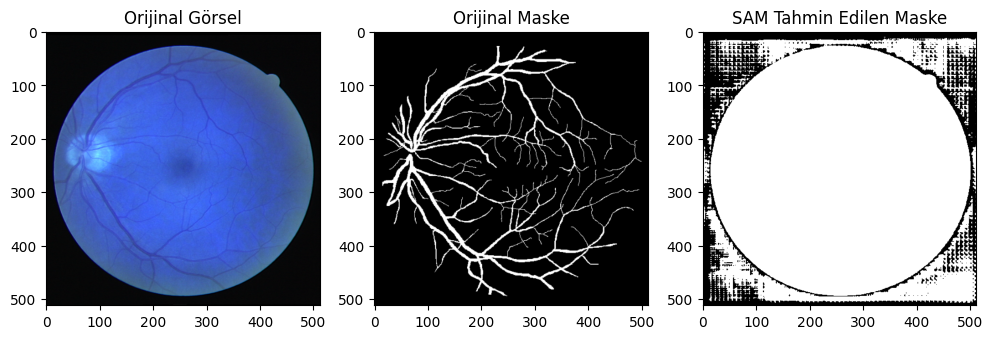

In [18]:
import matplotlib.pyplot as plt

# İlk tahmini görselleştirme
plt.figure(figsize=(12, 6))

# Orijinal Görsel
plt.subplot(1, 3, 1)
plt.imshow(images[0], cmap='gray')
plt.title('Orijinal Görsel')

# Orijinal Maske
plt.subplot(1, 3, 2)
plt.imshow(masks[0].squeeze(), cmap='gray')
plt.title('Orijinal Maske')

# SAM ile Tahmin Edilen Maske
plt.subplot(1, 3, 3)
plt.imshow(sam_masks[0].squeeze(), cmap='gray')
plt.title('SAM Tahmin Edilen Maske')

plt.show()

In [ ]:
output_mask_path = "/kaggle/working/SAM-Predictions/sam_segmented_mask.png"
cv2.imwrite(output_mask_path, masks[0] * 255)  # Maskeyi kaydedin

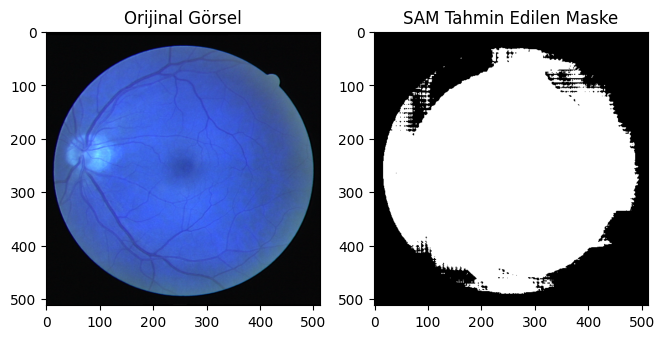

In [19]:
# SAM modelini yükleme
model_type = "vit_b"  # "vit_l" veya "vit_h" da kullanılabilir
sam_checkpoint_path = "/kaggle/working/sam_vit_b.pth"  # Modelin yüklü olduğu yol
sam = sam_model_registry[model_type](checkpoint=sam_checkpoint_path)
sam.to('cuda')

# SAM Predictoru oluşturma
predictor = SamPredictor(sam)

# Tıklama noktalarını ayarlama
# Örnek olarak iki noktayı kullanıyoruz. Nokta (x, y) formatında olmalıdır.
point_coords = np.array([[250, 250], [300, 300]])  # İki farklı nokta
point_labels = np.array([1, 1])  # 1 segmentasyon yapılacak, 0 segmentasyon yapılmayacak

# Görüntüyü SAM'e set etme
predictor.set_image(images[0])

# Tıklama noktaları ile segmentasyon yapma
masks, _, _ = predictor.predict(point_coords=point_coords, point_labels=point_labels, multimask_output=False)

# Sonucu görselleştirme
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))

# Orijinal Görsel
plt.subplot(1, 3, 1)
plt.imshow(images[0], cmap='gray')
plt.title('Orijinal Görsel')

# SAM ile Tahmin Edilen Maske
plt.subplot(1, 3, 2)
plt.imshow(masks.squeeze(), cmap='gray')
plt.title('SAM Tahmin Edilen Maske')

plt.show()

SAM v2

In [31]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator


In [32]:
torch.cuda.empty_cache()

In [33]:
!pip install 'git+https://github.com/facebookresearch/segment-anything.git'

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-lz88qkyf
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-lz88qkyf
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 526fd066dea338ba2ca08886853bd37ffd6a8aec
  Preparing metadata (setup.py) ... done


In [34]:
# checkpoint noktası
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

--2024-09-04 10:54:36--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 13.35.7.38, 13.35.7.50, 13.35.7.82, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|13.35.7.38|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2564550879 (2.4G) [binary/octet-stream]
Saving to: 'sam_vit_h_4b8939.pth'

sam_vit_h_4b8939.pt 100%[===================>]   2.39G   147MB/s    in 17s     

2024-09-04 10:54:53 (142 MB/s) - 'sam_vit_h_4b8939.pth' saved [2564550879/2564550879]



In [6]:
# Listeler oluşturma
images = []
masks = []

# FIVES veri seti için görseller ve maskeleri listelere ekle
for i, image_path in enumerate(fivesdata_images):
    img_name = os.path.splitext(os.path.basename(image_path))[0]
    
    # Maskeyi bul
    mask_path = next((mask for mask in fivesdata_mask if os.path.splitext(os.path.basename(mask))[0] == img_name), None)
    
    if mask_path:
        img = cv2.imread(image_path)
        images.append(img)
        mask = cv2.imread(mask_path)
        masks.append(mask)
    print(i)
        
# CHASEDB veri seti için görseller ve maskeleri listelere ekle
for i, image_path in enumerate(chasedb_images):
    img_name = os.path.splitext(os.path.basename(image_path))[0]
    
    # Maskeyi bul
    mask_path = next((mask for mask in chasedb_combined_mask if os.path.splitext(os.path.basename(mask))[0].replace('_combined', '') == img_name), None)
    
    if mask_path:
        img = cv2.imread(image_path)
        images.append(img)
        mask = cv2.imread(mask_path)
        masks.append(mask)
    print(i)


for i, image_path in enumerate(hrf_images):
    img_name = os.path.splitext(os.path.basename(image_path))[0]
    
    # Maskeyi bul
    mask_path = next((mask for mask in hrf_mask if os.path.splitext(os.path.basename(mask))[0] == img_name), None)
    
    if mask_path:
        img = cv2.imread(image_path)
        images.append(img)
        mask = cv2.imread(mask_path)
        masks.append(mask)
    print(i)

        
print(f"Görsel Path Seti Boyutu: {len(images)}")
print(f"Maske Path Seti Boyutu: {len(masks)}")

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

NameError: name 'chasedb_images' is not defined

In [7]:
import os
import cv2

# Kaydetme için dizinler oluştur (görseller ve maskeler için ayrı dizinler)
output_image_dir = '/kaggle/working/output_images'
output_mask_dir = '/kaggle/working/output_masks'

# Eğer klasörler mevcut değilse oluştur
os.makedirs(output_image_dir, exist_ok=True)
os.makedirs(output_mask_dir, exist_ok=True)

# Görselleri ve maskeleri kaydet
for i, (image, mask) in enumerate(zip(images, masks)):
    # Görselleri kaydet
    image_filename = os.path.join(output_image_dir, f'image_{i}.png')
    cv2.imwrite(image_filename, image)

    # Maskeleri kaydet
    mask_filename = os.path.join(output_mask_dir, f'mask_{i}.png')
    cv2.imwrite(mask_filename, mask)

    print(f"{i+1}. görsel ve maske kaydedildi: {image_filename}, {mask_filename}")

print("Tüm görseller ve maskeler başarıyla kaydedildi.")

1. görsel ve maske kaydedildi: /kaggle/working/output_images/image_0.png, /kaggle/working/output_masks/mask_0.png
2. görsel ve maske kaydedildi: /kaggle/working/output_images/image_1.png, /kaggle/working/output_masks/mask_1.png
3. görsel ve maske kaydedildi: /kaggle/working/output_images/image_2.png, /kaggle/working/output_masks/mask_2.png
4. görsel ve maske kaydedildi: /kaggle/working/output_images/image_3.png, /kaggle/working/output_masks/mask_3.png
5. görsel ve maske kaydedildi: /kaggle/working/output_images/image_4.png, /kaggle/working/output_masks/mask_4.png
6. görsel ve maske kaydedildi: /kaggle/working/output_images/image_5.png, /kaggle/working/output_masks/mask_5.png
7. görsel ve maske kaydedildi: /kaggle/working/output_images/image_6.png, /kaggle/working/output_masks/mask_6.png
8. görsel ve maske kaydedildi: /kaggle/working/output_images/image_7.png, /kaggle/working/output_masks/mask_7.png
9. görsel ve maske kaydedildi: /kaggle/working/output_images/image_8.png, /kaggle/workin

In [8]:
images_list = []
mask_list = []

images_dir = glob("/kaggle/working/output_images/*.png")
mask_dir = glob("/kaggle/working/output_masks/*.png")

for image in images_dir:
    images_list.append(image)

for mask in mask_dir:
    mask_list.append(mask)

# Görsel ve maske sayısını ekrana yazdır
print(f"Toplam görsel sayısı: {len(images_list)}")
print(f"Toplam maske sayısı: {len(mask_list)}")

Toplam görsel sayısı: 750
Toplam maske sayısı: 750


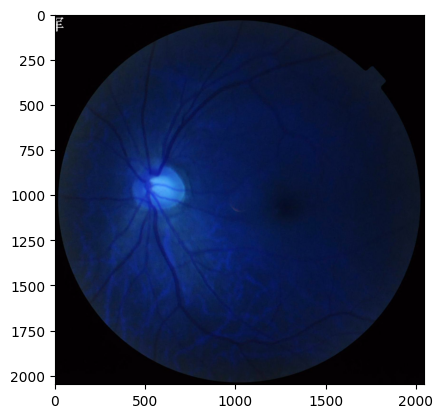

[[[3 0 2]
  [3 0 2]
  [3 0 2]
  ...
  [3 0 2]
  [3 0 2]
  [3 0 2]]

 [[3 0 2]
  [3 0 2]
  [3 0 2]
  ...
  [3 0 2]
  [3 0 2]
  [3 0 2]]

 [[3 0 2]
  [3 0 2]
  [3 0 2]
  ...
  [3 0 2]
  [3 0 2]
  [3 0 2]]

 ...

 [[4 1 3]
  [4 1 3]
  [4 1 3]
  ...
  [4 1 3]
  [4 1 3]
  [4 1 3]]

 [[4 1 3]
  [4 1 3]
  [4 1 3]
  ...
  [4 1 3]
  [4 1 3]
  [4 1 3]]

 [[4 1 3]
  [4 1 3]
  [4 1 3]
  ...
  [4 1 3]
  [4 1 3]
  [4 1 3]]]


In [90]:
plt.imshow(images[0])
plt.show()
print(images[0])

(2048, 2048, 3)


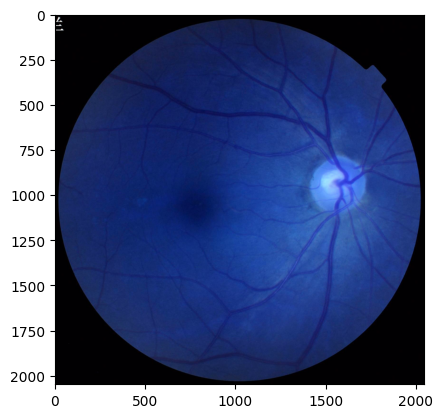

(2048, 2048, 3)


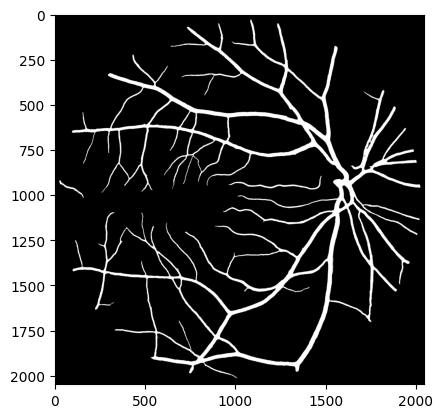

In [69]:
img_path = fivesdata_images[1]
img = cv2.imread(img_path)
plt.imshow(img)
print(img.shape)
plt.show()

mask_path = fivesdata_mask[1]
mask = cv2.imread(mask_path)
plt.imshow(mask)
print(mask.shape)

In [9]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from torch.cuda.amp import GradScaler, autocast
from tqdm import tqdm
import torch.utils.checkpoint as checkpoint

In [10]:
# Basit başlık (head) sınıfı gradient checkpointing ile
class CheckpointedSimpleHead(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(CheckpointedSimpleHead, self).__init__()
        self.fc = nn.Linear(input_dim, output_dim)

    def forward(self, x):
        x = torch.flatten(x, start_dim=1)  # Girişi flatten et
        return checkpoint.checkpoint(self.fc, x)

In [11]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Modeli ve optimizasyonu tanımlayın
input_dim = 128 * 128 * 3  # Flatten işleminden sonra elde edilen tensör boyutu
output_dim = 128 * 128  # Maskelerin boyutu
head = CheckpointedSimpleHead(input_dim=input_dim, output_dim=output_dim)

# Parametrelerin gradyan hesaplaması için ayarlanması
for param in head.parameters():
    param.requires_grad = True  # Gradyan hesaplamayı etkinleştir

# Cihaz ve optimizasyon ayarları
head.to(device)
optimizer = optim.Adam(head.parameters(), lr=0.001)
criterion = nn.BCEWithLogitsLoss()

# SAM modelini yükleyin
sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"
sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device)
mask_generator = SamAutomaticMaskGenerator(sam)

# Veri seti ve DataLoader ayarları
transform = transforms.Compose([
    transforms.Resize((128, 128))  # Daha küçük boyutlara 
])

/opt/conda/lib/python3.10/site-packages/segment_anything/build_sam.py:105: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(f)


In [23]:
images = np.array(images_list)
images_tensor = torch.from_numpy(images)
masks = np.array(mask_list)
images_tensor = torch.from_numpy(masks)

TypeError: can't convert np.ndarray of type numpy.str_. The only supported types are: float64, float32, float16, complex64, complex128, int64, int32, int16, int8, uint64, uint32, uint16, uint8, and bool.

In [19]:
class EyeDataset(Dataset):
    def __init__(self, image, masks, transform=None):
        self.images= image
        self.masks = masks
        self.transform = transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image = self.images[idx]
        mask = self.masks[idx]

        #image = torch.tensor(image).float().permute(2, 0, 1)
        #mask = torch.tensor(mask).float().unsqueeze(0)
        
        return image, mask
    
dataset = EyeDataset(image=images, masks=masks, transform=transform)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True, pin_memory=True)

In [22]:
from tqdm import tqdm
# Eğitim döngüsü
for epoch in range(10):
    head.train()
    running_loss = 0.0
    for images, masks in tqdm(dataloader, desc=f"Epoch {epoch+1}"):
        images = images.to(device)
        masks = masks.to(device).float()

        optimizer.zero_grad()

        # SAM modelini kullanarak maskeler üretin
        generated_masks = []
        for image in images:
            image = image.permute(2, 1, 0)
            #print(image.shape)
            
            resized_image = transform(image)
            #print(resized_image.shape)

            with torch.no_grad():
                image_np = resized_image.permute(1, 2, 0).cpu().numpy()  # [128, 128, 3]
                #print(image_np.shape)
                
            sam_masks = mask_generator.generate(image_np)
            print(sam_masks.shape)
            generated_masks.append(torch.tensor(sam_masks[0]['segmentation']).unsqueeze(0))
        #print(len(generated_masks))
        #break

        # [batch_size, 1, 128, 128] -> [batch_size, 128 * 128]
        generated_masks = torch.stack(generated_masks).to(device).float()

        # Flatten işlemi
        generated_masks = generated_masks.view(generated_masks.size(0), -1)  # [batch_size, 128*128]

        # Giriş boyutlarını uygun hale getirdikten sonra model başlığına (head) gönder
        outputs = head(generated_masks)

        # Modelin çıkışını yeniden şekillendir
        outputs = outputs.view(4, 1, 128, 128)  # [batch_size, 1, 128, 128]
        # Kaybı hesapla
        loss = criterion(outputs, masks)

        # Geri yayılım ve optimizasyon
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch {epoch+1}, Loss: {running_loss/len(dataloader)}")

    # GPU belleğini temizleyin
    torch.cuda.empty_cache()

Epoch 1:   0%|          | 0/188 [00:00<?, ?it/s]


AttributeError: 'list' object has no attribute 'float'

- SILME ISLEMLERI 

In [67]:
# DOSYA SILME # 
# Silmek istediğiniz dosyanın yolu
file_path = glob("/kaggle/working/HRF-Data/Mask/*.png")
for image_path in file_path:
    os.remove(image_path)

In [42]:
# KLASÖR SILME #
# Silmek istediğiniz klasörün yolu
folder_path = "/kaggle/working/Chasedb-Data/Combined_Mask"

# Klasörü ve içindekileri silme
shutil.rmtree(folder_path)